In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

from generate_data import shift_image, get_object_mask
from frame_converter import FrameConverter

In [3]:
def get_object_shift(amplitude, frequency, time):
    return amplitude * np.sin(2*np.pi*frequency * time)

In [4]:
def generate_data(
    obj1: np.ndarray,
    obj2: np.ndarray,
    obj1_freq: float,
    obj1_ampl: int,
    obj2_freq: float,
    obj2_ampl: int,
    time_step: float,
    generation_time: float
):
    # obj1_period = 1 / obj1_freq
    # obj2_period = 1 / obj2_freq
    
    generated_data = []
    elapsed_time = 0
    while elapsed_time < generation_time:
        # get objects shift
        obj1_shift = int(get_object_shift(obj1_ampl, obj1_freq, elapsed_time))
        obj2_shift = int(get_object_shift(obj2_ampl, obj2_freq, elapsed_time))
        
        # shift the fist object (background)
        obj1_shifted = shift_image(obj1, x=0, y=obj1_shift)
        
        # set the second object coordinates on the first object
        # accounting for first and second objects shifts
        # (in the center right now)
        obj2_x_coord = int(obj1.shape[1] // 2)
        obj2_y_coord = int(obj1.shape[0] // 2 + obj1_shift + obj2_shift)
        
        # get object 2 mask
        obj2_mask = get_object_mask(obj2)
        
        # place object 2 on object 1 as image
        obj1_image = Image.fromarray(obj1_shifted)
        obj2_image = Image.fromarray(obj2)
        
        obj1_image.paste(obj2_image, (obj2_x_coord, obj2_y_coord), mask=obj2_mask)        
        
        generated_data.append(np.asarray(obj1_image))
        elapsed_time += time_step
        
    return generated_data

In [5]:
car = cv2.imread("../data/car_bottom/car_bottom1.jpg")
bomb = cv2.imread("../data/bombs/c4_csgo.webp")

car = cv2.cvtColor(car, cv2.COLOR_BGR2RGB)
bomb = cv2.cvtColor(bomb, cv2.COLOR_BGR2RGB)

car = cv2.cvtColor(car, cv2.COLOR_RGB2GRAY)
bomb = cv2.cvtColor(bomb, cv2.COLOR_RGB2GRAY)

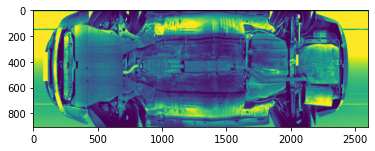

In [6]:
plt.imshow(car)

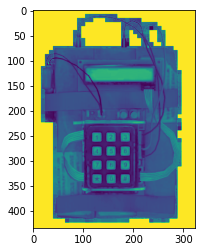

In [7]:
plt.imshow(bomb)

In [8]:
car = cv2.resize(car, (640, 640))
bomb = cv2.resize(bomb, (64, 64))

In [9]:
generated_data = generate_data(
    car, bomb,
    obj1_freq=10, obj1_ampl=20,
    obj2_freq=20, obj2_ampl=10,
    time_step=1/30,
    generation_time=2
)

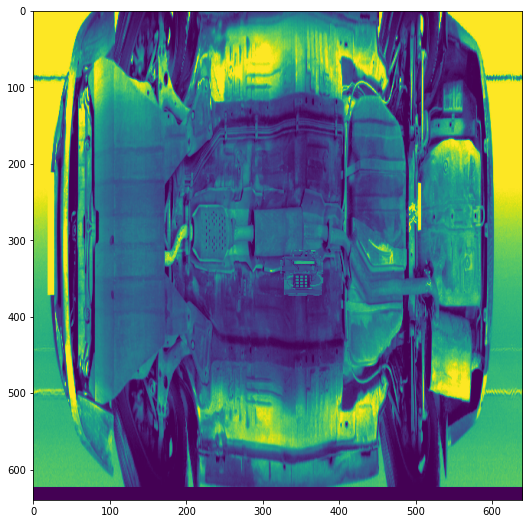

In [10]:
plt.figure(figsize=(16, 9))
plt.imshow(generated_data[2])
plt.show()

In [11]:
len(generated_data)

60

In [12]:
converter = FrameConverter("freq", epsilon=170)

In [13]:
converted_data = converter.convert_frames(generated_data)

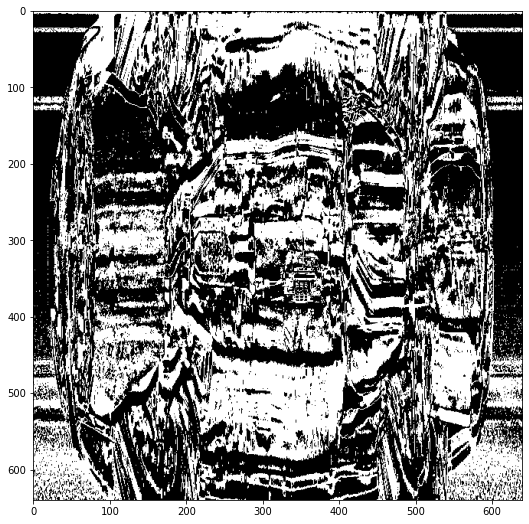

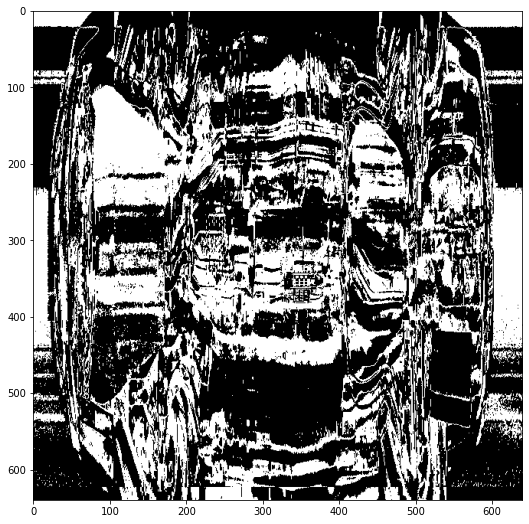

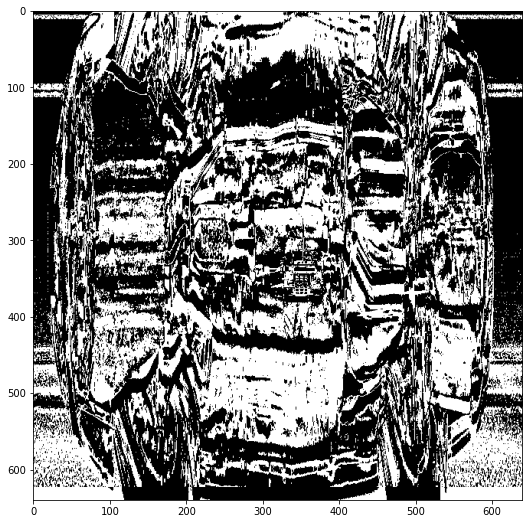

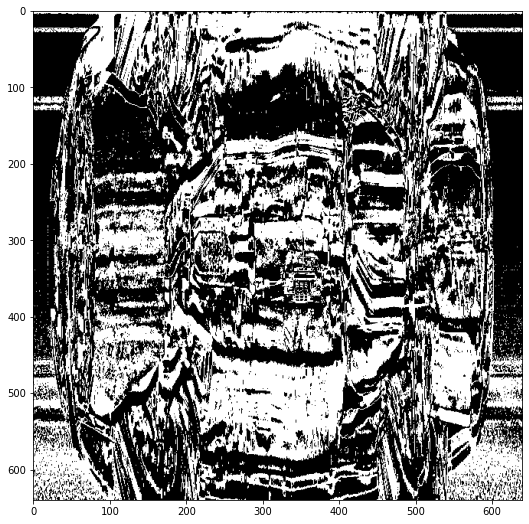

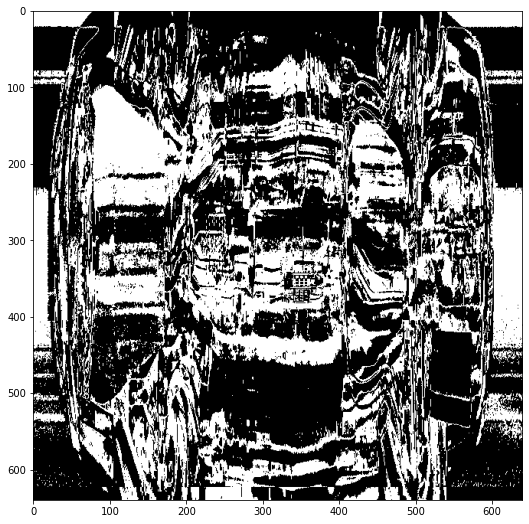

...

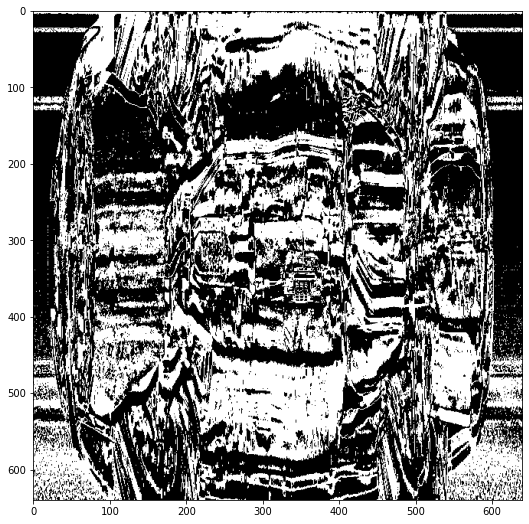

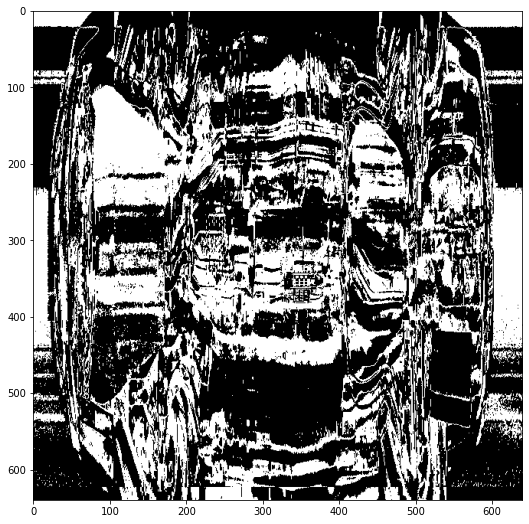

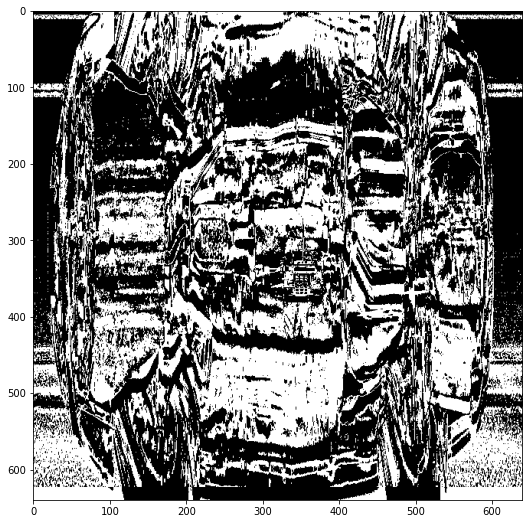

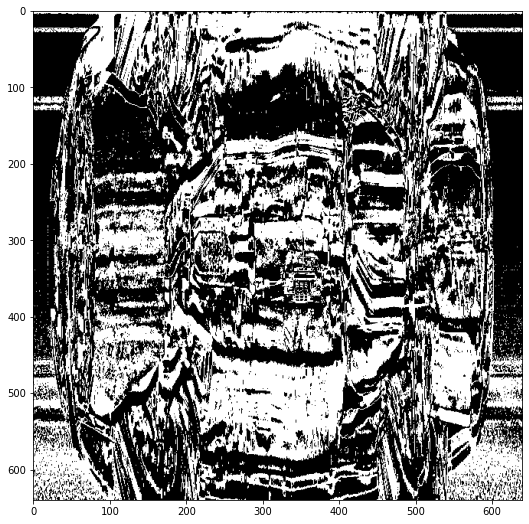

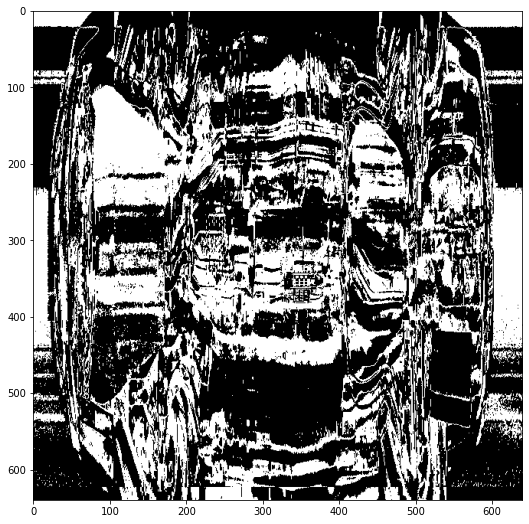

In [15]:
for i in range(len(converted_data)):
    plt.figure(figsize=(16, 9))
    plt.imshow(converted_data[i], cmap="gray")
    plt.show()